# Heatmaps and mass spectra interactive plots

In [1]:
import numpy as np
import pandas as pd

import matplotlib.pyplot as plt

from ipywidgets import interact, IntSlider

In [2]:
coso_data = pd.read_csv('./data/cleaned_types.csv')

In [3]:
def norm(s, norm_type):
    if norm_type == 'max':
        if np.nanmax(s) == 0:
            return s
        else:
            return s / np.nanmax(s)
    if norm_type == 'std':
        if np.std(s) == 0:
            return s
        else:
            return s / np.std(s)

In [4]:
names = []
for name in list(coso_data['Well ID'].unique()):
    try:
        name / 1
    except TypeError:
        # These wells are missing depths, so we will skip them.
        if name in ['38C9', '47A-8', '84-30']:
            continue
        names.append(name)

In [5]:
# Make the C02/N2 ratio Series
print(coso_data.shape)
coso_data['CO2/N2 ratio'] = coso_data['AMU44'] / coso_data['AMU28']
coso_data['CO2/N2 ratio'].shape

(9712, 192)


(9712,)

In [6]:
# Make slope data (difference in ratio every 100ft depth)
uprs = coso_data['CO2/N2 ratio'][::5][:-1]
lwrs = coso_data['CO2/N2 ratio'][::5][1:]
diff = uprs.values - lwrs.values

In [7]:
# get amu list by name and not index as that results in ValueError in some wells
amu_list = [name for name in coso_data.columns if 'AMU' in name ]

In [8]:
# Get total gas sum
coso_data['total_gas'] = coso_data[amu_list].sum(axis=1)
# divide diffs by total gas
slopes = diff / coso_data['total_gas'][::5][1:]

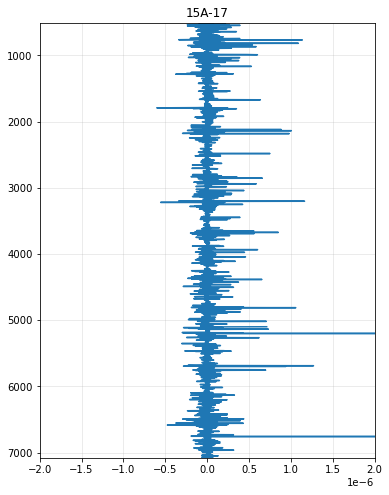

In [9]:
# plot the slope vs depth for a single well (testing)
wellname = '15A-17'
fig, ax = plt.subplots(figsize=(6, 8))
mii = coso_data.loc[coso_data['Well ID'] == wellname, 'Depth (ft)'].min()
maa = coso_data.loc[coso_data['Well ID'] == wellname, 'Depth (ft)'].max()
depths = np.linspace(mii, maa, diff.shape[0])
ax.plot(slopes, depths)
ax.set_ylim(maa, mii)
ax.set_xlim(-2e-6, 2e-6)
ax.set_title(wellname)
ax.grid(alpha=0.3)

In [10]:
# Getting depth range for slider
mii, maa = coso_data['Depth (ft)'].min(), coso_data['Depth (ft)'].max()

@interact(well_name=names,
          norm_type=['max', 'std'],
          depth=IntSlider(2010, mii, maa, 10, continuous_update=False)
         )
def make_heatplot(well_name, norm_type, depth):
    """Make heatplot and mass spectrum for given well at given depth"""
    # Get a list of the AMUs available
    amu_list = [name for name in coso_data.columns if 'AMU' in name ]

    # Get the AMUs for a specific well
    X = coso_data.loc[coso_data['Well ID'] == well_name, amu_list]
    X = np.nan_to_num(X.astype(float).values)
    
    # Normalise each AMU (column)
    X2 = np.apply_along_axis(norm, axis=0, arr=X, norm_type=norm_type)
    
    # Get depths for the plots
    depths = coso_data.loc[coso_data['Well ID'] == well_name, 'Depth (ft)']
    extents = (0, 1500, np.nanmax(depths), np.nanmin(depths))
    
    # Change the vmax based on the norm used
    ma = 5 if norm_type == 'std' else 1
    
    # Plotting stuff
    fig, axs = plt.subplots(figsize=(15,10), ncols=3)
    
    # heatmap
    ax = axs[1]
    im = ax.imshow(X2, vmax=ma, extent=extents)
    ax.set_title(f'{well_name}', fontsize=14)
    ax.set_ylabel('Depth (ft)')
    ax.set_xlabel('m/z')
    plt.colorbar(im, shrink=0.5, ax=ax, label='Normalized AMU intensity')
    ax.set_xticks(np.linspace(0, 1500, 7))
    ax.set_xticklabels(np.arange(0, 210, 30))
    
    ax.axhline(depth, c='r')
    
    # add mass spectrogram for given depth
    ax = axs[2]
    data = coso_data.loc[(coso_data['Well ID'] == well_name) &
                         (coso_data['Depth (ft)'] == depth),
                         amu_list].values
    try:
        data /= np.nanmax(data)
    except ValueError:
        print('No values at this depth, try +-10 ft')
        pass
    
    ax.plot(data.flatten())
    ax.set_title(f'Mass Spectrum for {well_name} at {depth} ft.', fontsize=14)
    ax.grid(alpha=0.3)
    for color, label, value, ls in zip('y b g r'.split(),
                                       'H2(AMU2) H20(AMU18) N2(AMU28) CO2(AMU44)'.split(),
                                       (2, 18, 28, 44),
                                       ('-', '--', '-.', ':')
                                      ):
        ax.axvline(value, label=label, c=color, lw=1, linestyle=ls)

    ax.legend()
    ax.set_xlabel('m/z')
    ax.set_ylabel('Relative abundance')
    ax.set_xticks(np.arange(0, 110, 10))
    ax.yaxis.set_label_position("right")
    ax.yaxis.tick_right()
    ax.set_xlim(0, 100)
    ax.set_ylim(0, 1)
    
    # permeability plot
    ax = axs[0]
    mii = coso_data.loc[coso_data['Well ID'] == well_name, 'Depth (ft)'].min()
    maa = coso_data.loc[coso_data['Well ID'] == well_name, 'Depth (ft)'].max()
    depths = np.linspace(mii, maa, diff.shape[0])
    ax.plot(slopes, depths)
    ax.set_ylim(maa, mii)
    ax.set_xlim(-2e-6, 2e-6)
    ax.grid(alpha=0.3)
    ax.set_title(f'{well_name} permeability slope')
    ax.set_xlabel('$CO2/N2/100ft/total_gas$')
    ax.set_ylabel('Depth (ft)')
    ax.axhline(depth, c='r')
    
    return None

interactive(children=(Dropdown(description='well_name', options=('15A-17', '23A-17', '23A-19', '24A-8', '337',…